# Model R_MC18:

In [0]:
ls

drive/  sample_data/


In [0]:
cd drive/My\ Drive/dataset/

/content/drive/My Drive/dataset


In [0]:
ls

32frame_exp_r2p1d_3/       graphs_2p1d.pth             sample_output_2p1d.png
32frame_exp_rmc18_3/       graphs.pth                  sample_output.png
32ucf2_frame_exp_rmc18_3/  Loss_2p1d.png               UCF11/
Accuracy_2p1d.png          Loss.png                    UCF2/
Accuracy.png               outputs_ucf11/              videoloader.py
checkpoint_vcm_2p1d.pth    __pycache__/                WMT_de_en/
checkpoint_vcm.pth         sample_output_2p1d_233.png  Youtube2Text/
Confusion_matrix_2p1d.png  sample_output_2p1d_300.png
Confusion_matrix_mc.png    sample_output_2p1d_324.png


## 1)Setting up path to dataset folder and files

In [0]:
annotation_path = 'UCF2/annotation/'
dataset_path = 'UCF2/dataset/'
class_labels_path= annotation_path+'classlabel.txt'
train_path = annotation_path+'train.txt'
test_path = annotation_path+'test.txt'

In [0]:
import os
import tqdm
import numpy as np

In [0]:
#utility function
def read_txt(filename):
  fd = open(filename,'r')
  data = fd.readlines()
  fd.close()
  for i in range(len(data)):
    data[i] = data[i].strip().split()
  return data

In [0]:
class_names = read_txt(class_labels_path)
class_names

[['walking'], ['golf_swing']]

In [0]:
train_list = read_txt(train_path)
len(train_list)
temp_list = []
shuffled_idx = np.arange(len(train_list))
np.random.shuffle(shuffled_idx)
print(shuffled_idx)
for i in shuffled_idx:
  temp_list.append(train_list[i])
train_list = temp_list.copy()
len(train_list)

[  2  98 161 178 116 102  16 125  54 115  32 131  27 163 176   3  50 156
 164  37 198 197  41  28   6 169 141 153  56  62  33  55  14  83 188 103
 165  25  88  79 124 182 110  84 167  19  46 189  59  60  22  75 142 144
  17 187 108 121  96  24 136  51  15  20 206  86 183  82 184 148  38 159
 196  58  89 132 135  29 130 152 179  23   9 145 207 190  12  52  26  93
 104   4  11  36  44 202 204  43 170 203 155 168  73  45 128 105  90 199
  71 209 154 186  81 120 139 117 140 201 126  77 210  18  35 200  47  97
 109  49 113  31 162 195  63  87 177 123  69 193 194  57 114  48 151 149
  78 172 173   1 208  34  67 118  10 158  72 119 185 205 160  74  66  30
 150 171   0 107 157  21  61  13  42  95 129 101  53 147  68  91 174  94
 127 112  80  40  65 122 137  64 191  39 143  85 133 175 111 146 106 138
  92 166  99 134 192 100 180  76   8   5 181   7  70]


211

In [0]:
test_list = read_txt(test_path)
len(test_list)

54

In [0]:
train_split = 0.8
val_split = 0.2

In [0]:
NUM_OF_TRAIN = int(train_split*(len(train_list)))
NUM_OF_VAL = int(val_split*(len(train_list)))
NUM_OF_TRAIN,NUM_OF_VAL

(168, 42)

In [0]:
import torch
import random
import torchvision

## 2) Configuration Setting

In [0]:
#setting up a seed for reproducibility of results
SEED = 1234
random.seed(SEED)
np.random.seed(SEED)
torch.manual_seed(SEED)
torch.cuda.manual_seed(SEED)
torch.backends.cudnn.deterministic = True

In [0]:
!sudo apt-get install python-opencv

Reading package lists... Done
Building dependency tree       
Reading state information... Done
python-opencv is already the newest version (3.2.0+dfsg-4ubuntu0.1).
0 upgraded, 0 newly installed, 0 to remove and 29 not upgraded.


In [0]:
import cv2
from PIL import Image
import matplotlib.pyplot as plt

In [0]:
mean = [0.43216, 0.394666, 0.37645]
std = [0.22803, 0.22145, 0.216989]
NUM_OF_CLASSES = len(class_names)
batch_size = 8
EPOCHES = 50
LENGTH_IN_FRAMES = 32
BETWEEN_CLIPS = 3

## 3) Dataloader for UCF11 Dataset

In [0]:
class VideoDataLoader(torch.utils.data.Dataset):
  def __init__(self,video_list,dataset_path,length_in_frames=LENGTH_IN_FRAMES,between_clips=BETWEEN_CLIPS,transform=None):
    self.video_list = video_list
    self.dataset_path = dataset_path
    self.transform = transform
    self.video_paths = []
    self.class_ids = []
    self.between_clips = between_clips
    self.length_in_frames = length_in_frames
    for i in range(len(self.video_list)):
      self.video_paths.append(self.dataset_path+self.video_list[i][0])
      self.class_ids.append(int(self.video_list[i][1])-1) #class number starts from 1 so need to subtract 1.
    
  def get_video(self,filename):
    cap = cv2.VideoCapture(filename)
    img_list = []
    count = 0 
    h,w = 0,0
    # r = random.randint(self.between_clips,5+self.between_clips)
    r = self.between_clips
    while True:
      status,img = cap.read()
      if status==True:
        if count% r == 0:
          h,w,c = img.shape
          img = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
          img_list.append(self.transform((Image.fromarray(img.copy(),'RGB'))).unsqueeze(0))

      elif (status == False)& (count!=0):
        if count% r == 0:
          img_list.append(self.transform((Image.fromarray(np.zeros((h,w,3),dtype=np.uint8), 'RGB'))).unsqueeze(0))
      else:
        print('Issue in file:',filename)
        print("NO SUCH VIDEO FILE FOUND!")
        break
      count +=1
      if len(img_list) >= self.length_in_frames:
        break
    cap.release()
    return torch.cat(img_list,dim=0)

  def __len__(self):
    return len(self.video_paths)
  
  def __getitem__(self,idx):
    video = self.get_video(filename=self.video_paths[idx])
    return video,torch.tensor(self.class_ids[idx],dtype=torch.long)

In [0]:
transform = torchvision.transforms.Compose([torchvision.transforms.Resize((112,112)),torchvision.transforms.ToTensor(),torchvision.transforms.Normalize(mean=mean,std=std)])

In [0]:
training_dataset = VideoDataLoader(video_list=train_list[:NUM_OF_TRAIN],dataset_path=dataset_path,transform=transform)
validation_dataset =VideoDataLoader(video_list=train_list[NUM_OF_TRAIN:],dataset_path=dataset_path,transform=transform)

In [0]:
train_loader = torch.utils.data.DataLoader(dataset=training_dataset,batch_size=batch_size,shuffle=True,num_workers=4)
val_loader = torch.utils.data.DataLoader(dataset=validation_dataset,batch_size=batch_size,shuffle=True,num_workers=4)

## 4) Video Classification Model

In [0]:
class MixedConv18(torch.nn.Module):
  def __init__(self,num_of_classes,fine_tune):
    super(MixedConv18,self).__init__()
    self.num_of_classes = num_of_classes
    model = torchvision.models.video.mc3_18(pretrained=fine_tune)
    model = list(model.children())[:-1] #removed last fc layer
    self.num_of_layers = len(model)
    self.mc18 = torch.nn.Sequential(*model)
    self.fc = torch.nn.Linear(in_features=512,out_features=self.num_of_classes,bias=True)
    self.finetune(flag=fine_tune)
  def forward(self,x):
    x = self.mc18(x)  
    x = self.fc(x.view(-1,512))
    return  x
  
  def finetune(self,flag):
    if flag == False:
      for p in self.mc18.parameters():
        p.requires_grad = True
    else:
      for p in self.mc18.parameters():
        p.requires_grad = False
      for c in list(self.mc18.children())[2:]:
        for p in c.parameters():
          p.requires_grad = flag

In [0]:
model = MixedConv18(num_of_classes=NUM_OF_CLASSES,fine_tune=True).cuda()

In [0]:
source=str(LENGTH_IN_FRAMES)+'ucf2_frame_exp_rmc18_'+str(BETWEEN_CLIPS)+'/'
os.system('mkdir '+source)
checkpoint_path = source+'checkpoint_r_mc18_32f.pth'
loss_fig_path = source+'Loss.png'
acc_fig_path = source+'acc.png'
confusion_matrix_path = source+'confusion_matrix.png'
graph_hist_path = source+'graph_hist.pth'

In [0]:
optimizer = torch.optim.Adam(params=model.parameters(),lr=1e-2)
loss_fn = torch.nn.CrossEntropyLoss().cuda()
train_loss_hist = []
val_loss_hist = []
top1_acc = []
# top3_acc = []
epoches = []
best_top1 = 0
best_epoch = 0

In [0]:
#utility fuction
def softmax(x):
  return torch.exp(x)/torch.sum(torch.exp(x))

## 5) Training Pipeline

In [0]:
for e in tqdm.tqdm(range(EPOCHES)):
  epoches.append(e)
  train_loss = 0
  val_loss = 0
  train_count = 0
  val_count = 0
  top1_count = 0
  top3_count = 0
  model.train()
  for i,(x,y) in enumerate(train_loader):
      optimizer.zero_grad()
      output = model(x[:,:,:,:,:].view(x.shape[0],3,-1,112,112).cuda())
      loss = loss_fn(output,y.cuda())
      loss.backward()
      optimizer.step()
      train_loss += loss.item()
      train_count +=batch_size
  train_loss_hist.append(train_loss/train_count)

  model.eval()
  with torch.no_grad():
    for i,(x,y) in enumerate(val_loader):
        output = model(x[:,:,:,:,:].view(x.shape[0],3,-1,112,112).cuda())
        loss = loss_fn(output,y.cuda())
        val_loss += loss.item()
        val_count += batch_size
        
        value_top1,idx_top1 = softmax(output).topk(1)
        # value_top3,idx_top3 = softmax(output).topk(3)
        for j in range(y.shape[0]):
          if y[j].cuda() in idx_top1:
            top1_count += 1
          # if y[j].cuda() in idx_top3:
          #   top3_count += 1
    val_loss_hist.append(val_loss/val_count)
    top1_acc.append(top1_count/val_count)
    # top3_acc.append(top3_count/val_count)
  # print('Epoch: ',e,'train_loss: ',train_loss/train_count,'val_loss: ',val_loss/val_count,'top1_acc:',top1_count/val_count,'top3_acc:',top3_count/val_count,'best_top1:',best_top1,'best_epoch:',best_epoch)
  print('Epoch: ',e,'train_loss: ',train_loss/train_count,'val_loss: ',val_loss/val_count,'top1_acc:',top1_count/val_count,'best_top1:',best_top1,'best_epoch:',best_epoch)
  if best_top1 < (top1_count/val_count):
    best_epoch = e
    best_top1 = (top1_count/val_count)
    torch.save({'model':model.state_dict(),'optimizer':optimizer,'loss_fn':loss_fn,'epoch':e},checkpoint_path)
    # torch.save({'train_loss':train_loss_hist,'val_loss':val_loss_hist,'top1_acc':top1_acc,'top3_acc':top3_acc},graph_hist_path)
    torch.save({'train_loss':train_loss_hist,'val_loss':val_loss_hist,'top1_acc':top1_acc},graph_hist_path)

  0%|          | 0/50 [00:00<?, ?it/s]

Epoch:  0 train_loss:  0.13115472053842886 val_loss:  15.574114163716635 top1_acc: 0.75 best_top1: 0 best_epoch: 0


  2%|▏         | 1/50 [00:14<12:08, 14.86s/it]

Epoch:  1 train_loss:  0.05410968494557199 val_loss:  0.26498595252633095 top1_acc: 0.8958333333333334 best_top1: 0.75 best_epoch: 0


  6%|▌         | 3/50 [00:44<11:34, 14.78s/it]

Epoch:  2 train_loss:  0.04035582903417803 val_loss:  0.07287421174502622 top1_acc: 0.8958333333333334 best_top1: 0.8958333333333334 best_epoch: 1


  8%|▊         | 4/50 [00:58<11:16, 14.71s/it]

Epoch:  3 train_loss:  0.03167067175464971 val_loss:  0.03562966066723069 top1_acc: 0.875 best_top1: 0.8958333333333334 best_epoch: 1


 10%|█         | 5/50 [01:13<10:59, 14.66s/it]

Epoch:  4 train_loss:  0.033899406459005105 val_loss:  0.011732247890904546 top1_acc: 0.8958333333333334 best_top1: 0.8958333333333334 best_epoch: 1


 12%|█▏        | 6/50 [01:28<10:44, 14.64s/it]

Epoch:  5 train_loss:  0.03156354114235867 val_loss:  0.010467644625653824 top1_acc: 0.8958333333333334 best_top1: 0.8958333333333334 best_epoch: 1


 14%|█▍        | 7/50 [01:42<10:28, 14.62s/it]

Epoch:  6 train_loss:  0.03131669941580012 val_loss:  0.0771003143551449 top1_acc: 0.8958333333333334 best_top1: 0.8958333333333334 best_epoch: 1


 16%|█▌        | 8/50 [01:57<10:13, 14.61s/it]

Epoch:  7 train_loss:  0.0242397187809859 val_loss:  0.00475390757007214 top1_acc: 0.8958333333333334 best_top1: 0.8958333333333334 best_epoch: 1


 18%|█▊        | 9/50 [02:11<09:58, 14.59s/it]

Epoch:  8 train_loss:  0.04389453865587711 val_loss:  0.02301261087995954 top1_acc: 0.8958333333333334 best_top1: 0.8958333333333334 best_epoch: 1


 20%|██        | 10/50 [02:26<09:43, 14.59s/it]

Epoch:  9 train_loss:  0.03780924120829219 val_loss:  0.024253163874770205 top1_acc: 0.8958333333333334 best_top1: 0.8958333333333334 best_epoch: 1


 22%|██▏       | 11/50 [02:40<09:28, 14.58s/it]

Epoch:  10 train_loss:  0.018230555756461053 val_loss:  0.004870955444251497 top1_acc: 0.8958333333333334 best_top1: 0.8958333333333334 best_epoch: 1


 24%|██▍       | 12/50 [02:55<09:13, 14.56s/it]

Epoch:  11 train_loss:  0.022853803421769823 val_loss:  0.030730831533825647 top1_acc: 0.8958333333333334 best_top1: 0.8958333333333334 best_epoch: 1


 26%|██▌       | 13/50 [03:09<08:59, 14.57s/it]

Epoch:  12 train_loss:  0.027477881383328212 val_loss:  0.0386267671516786 top1_acc: 0.8958333333333334 best_top1: 0.8958333333333334 best_epoch: 1


 28%|██▊       | 14/50 [03:24<08:44, 14.56s/it]

Epoch:  13 train_loss:  0.01132136873812193 val_loss:  0.030703598943849403 top1_acc: 0.8958333333333334 best_top1: 0.8958333333333334 best_epoch: 1


 30%|███       | 15/50 [03:39<08:29, 14.55s/it]

Epoch:  14 train_loss:  0.009685559907839411 val_loss:  0.027574983425438404 top1_acc: 0.8958333333333334 best_top1: 0.8958333333333334 best_epoch: 1


 32%|███▏      | 16/50 [03:53<08:14, 14.55s/it]

Epoch:  15 train_loss:  0.05309897825299274 val_loss:  0.06035283533856273 top1_acc: 0.8958333333333334 best_top1: 0.8958333333333334 best_epoch: 1


 34%|███▍      | 17/50 [04:08<08:00, 14.56s/it]

Epoch:  16 train_loss:  0.016022059512102886 val_loss:  0.02778613893315196 top1_acc: 0.8958333333333334 best_top1: 0.8958333333333334 best_epoch: 1


 36%|███▌      | 18/50 [04:22<07:46, 14.57s/it]

Epoch:  17 train_loss:  0.06359688609483696 val_loss:  0.03842667986949285 top1_acc: 0.8958333333333334 best_top1: 0.8958333333333334 best_epoch: 1


 38%|███▊      | 19/50 [04:37<07:32, 14.59s/it]

Epoch:  18 train_loss:  0.0144809896924666 val_loss:  0.030214622771988314 top1_acc: 0.8958333333333334 best_top1: 0.8958333333333334 best_epoch: 1


 40%|████      | 20/50 [04:51<07:17, 14.58s/it]

Epoch:  19 train_loss:  0.012236358775269417 val_loss:  0.016928975528571755 top1_acc: 0.8958333333333334 best_top1: 0.8958333333333334 best_epoch: 1


 42%|████▏     | 21/50 [05:06<07:02, 14.57s/it]

Epoch:  20 train_loss:  0.008165551460392419 val_loss:  0.014890913385897875 top1_acc: 0.8958333333333334 best_top1: 0.8958333333333334 best_epoch: 1


 44%|████▍     | 22/50 [05:21<06:47, 14.56s/it]

Epoch:  21 train_loss:  0.004097569046453351 val_loss:  0.08405776314126949 top1_acc: 0.8958333333333334 best_top1: 0.8958333333333334 best_epoch: 1


 46%|████▌     | 23/50 [05:35<06:33, 14.56s/it]

Epoch:  22 train_loss:  0.018263053747692277 val_loss:  0.0921576024654011 top1_acc: 0.8958333333333334 best_top1: 0.8958333333333334 best_epoch: 1


 48%|████▊     | 24/50 [05:50<06:18, 14.55s/it]

Epoch:  23 train_loss:  0.02065905054942483 val_loss:  0.024824658874422312 top1_acc: 0.8958333333333334 best_top1: 0.8958333333333334 best_epoch: 1


 50%|█████     | 25/50 [06:04<06:04, 14.56s/it]

Epoch:  24 train_loss:  0.008170848268838156 val_loss:  0.03439497874933295 top1_acc: 0.8958333333333334 best_top1: 0.8958333333333334 best_epoch: 1


 52%|█████▏    | 26/50 [06:19<05:49, 14.57s/it]

Epoch:  25 train_loss:  0.024623731993848368 val_loss:  0.015559541682402292 top1_acc: 0.8958333333333334 best_top1: 0.8958333333333334 best_epoch: 1


 54%|█████▍    | 27/50 [06:33<05:35, 14.57s/it]

Epoch:  26 train_loss:  0.03245624700295074 val_loss:  0.05768948933109641 top1_acc: 0.7708333333333334 best_top1: 0.8958333333333334 best_epoch: 1


 56%|█████▌    | 28/50 [06:48<05:20, 14.57s/it]

Epoch:  27 train_loss:  0.006524971553257534 val_loss:  0.014154672040604055 top1_acc: 0.8958333333333334 best_top1: 0.8958333333333334 best_epoch: 1


 58%|█████▊    | 29/50 [07:03<05:06, 14.57s/it]

Epoch:  28 train_loss:  0.0027419508745272956 val_loss:  0.0033849527244456112 top1_acc: 0.8958333333333334 best_top1: 0.8958333333333334 best_epoch: 1


 60%|██████    | 30/50 [07:17<04:51, 14.58s/it]

Epoch:  29 train_loss:  0.002142960560463724 val_loss:  0.0036457945680012926 top1_acc: 0.8958333333333334 best_top1: 0.8958333333333334 best_epoch: 1


 62%|██████▏   | 31/50 [07:32<04:36, 14.58s/it]

Epoch:  30 train_loss:  0.0221415639943665 val_loss:  0.02987882330004747 top1_acc: 0.8958333333333334 best_top1: 0.8958333333333334 best_epoch: 1


 64%|██████▍   | 32/50 [07:46<04:22, 14.58s/it]

Epoch:  31 train_loss:  0.022246538661420345 val_loss:  0.06199407484382391 top1_acc: 0.8958333333333334 best_top1: 0.8958333333333334 best_epoch: 1


 66%|██████▌   | 33/50 [08:01<04:07, 14.56s/it]

Epoch:  32 train_loss:  0.013001038138532922 val_loss:  0.00395888312535438 top1_acc: 0.8958333333333334 best_top1: 0.8958333333333334 best_epoch: 1


 68%|██████▊   | 34/50 [08:15<03:53, 14.57s/it]

Epoch:  33 train_loss:  0.009192345885648615 val_loss:  0.17212742512735227 top1_acc: 0.8958333333333334 best_top1: 0.8958333333333334 best_epoch: 1


 70%|███████   | 35/50 [08:30<03:38, 14.56s/it]

Epoch:  34 train_loss:  0.0023717364473711876 val_loss:  0.009568979861796834 top1_acc: 0.8958333333333334 best_top1: 0.8958333333333334 best_epoch: 1


 72%|███████▏  | 36/50 [08:44<03:23, 14.56s/it]

Epoch:  35 train_loss:  0.0028258001520520167 val_loss:  0.004280418157577515 top1_acc: 0.8958333333333334 best_top1: 0.8958333333333334 best_epoch: 1


 74%|███████▍  | 37/50 [08:59<03:09, 14.55s/it]

Epoch:  36 train_loss:  0.001280679145739192 val_loss:  0.014434680861692565 top1_acc: 0.8958333333333334 best_top1: 0.8958333333333334 best_epoch: 1


 76%|███████▌  | 38/50 [09:14<02:54, 14.55s/it]

Epoch:  37 train_loss:  0.0019659588468216712 val_loss:  0.012633796160419783 top1_acc: 0.8958333333333334 best_top1: 0.8958333333333334 best_epoch: 1


 78%|███████▊  | 39/50 [09:28<02:40, 14.56s/it]

Epoch:  38 train_loss:  0.014883331644038359 val_loss:  0.020905380578672823 top1_acc: 0.8958333333333334 best_top1: 0.8958333333333334 best_epoch: 1


 80%|████████  | 40/50 [09:43<02:25, 14.57s/it]

Epoch:  39 train_loss:  0.015263051725924015 val_loss:  0.02429690935726588 top1_acc: 0.8958333333333334 best_top1: 0.8958333333333334 best_epoch: 1


 82%|████████▏ | 41/50 [09:57<02:11, 14.59s/it]

Epoch:  40 train_loss:  0.019244521545867126 val_loss:  0.67660986383756 top1_acc: 0.8541666666666666 best_top1: 0.8958333333333334 best_epoch: 1


 84%|████████▍ | 42/50 [10:12<01:56, 14.57s/it]

Epoch:  41 train_loss:  0.015586427501624539 val_loss:  0.12468196048090856 top1_acc: 0.8958333333333334 best_top1: 0.8958333333333334 best_epoch: 1


 86%|████████▌ | 43/50 [10:26<01:42, 14.57s/it]

Epoch:  42 train_loss:  0.005982653038310153 val_loss:  0.003343678079545498 top1_acc: 0.8958333333333334 best_top1: 0.8958333333333334 best_epoch: 1


 88%|████████▊ | 44/50 [10:41<01:27, 14.57s/it]

Epoch:  43 train_loss:  0.0018284600228071213 val_loss:  0.0011843281487623851 top1_acc: 0.8958333333333334 best_top1: 0.8958333333333334 best_epoch: 1


 90%|█████████ | 45/50 [10:56<01:12, 14.59s/it]

Epoch:  44 train_loss:  0.0025529274273486365 val_loss:  0.0025049565786806247 top1_acc: 0.8958333333333334 best_top1: 0.8958333333333334 best_epoch: 1


 92%|█████████▏| 46/50 [11:10<00:58, 14.59s/it]

Epoch:  45 train_loss:  0.0009998641021194913 val_loss:  0.0016668106739719708 top1_acc: 0.8958333333333334 best_top1: 0.8958333333333334 best_epoch: 1


 94%|█████████▍| 47/50 [11:25<00:43, 14.59s/it]

Epoch:  46 train_loss:  0.0017344506812237558 val_loss:  0.0007361978714470752 top1_acc: 0.8958333333333334 best_top1: 0.8958333333333334 best_epoch: 1


 96%|█████████▌| 48/50 [11:39<00:29, 14.60s/it]

Epoch:  47 train_loss:  0.0003071327117227373 val_loss:  0.0009006410837173462 top1_acc: 0.8958333333333334 best_top1: 0.8958333333333334 best_epoch: 1


 98%|█████████▊| 49/50 [11:54<00:14, 14.59s/it]

Epoch:  48 train_loss:  0.001757581141732988 val_loss:  0.0015949675968537729 top1_acc: 0.8958333333333334 best_top1: 0.8958333333333334 best_epoch: 1


100%|██████████| 50/50 [12:09<00:00, 14.58s/it]

Epoch:  49 train_loss:  0.0007383178564764204 val_loss:  0.0008646920323371887 top1_acc: 0.8958333333333334 best_top1: 0.8958333333333334 best_epoch: 1


In [0]:
!nvidia-smi

Sun May 10 17:17:10 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 440.82       Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   68C    P0    46W / 250W |   3059MiB / 16280MiB |      0%      Default |
+-------------------------------+----------------------+----------------------+
                                                                               
+-----------------------------------------------------------------------------+
| Processes:                                                       GPU Memory |
|  GPU  

In [0]:
len(epoches),len(train_loss_hist),len(val_loss_hist),len(top1_acc)

(50, 50, 50, 50)

## 6) Loss Graph

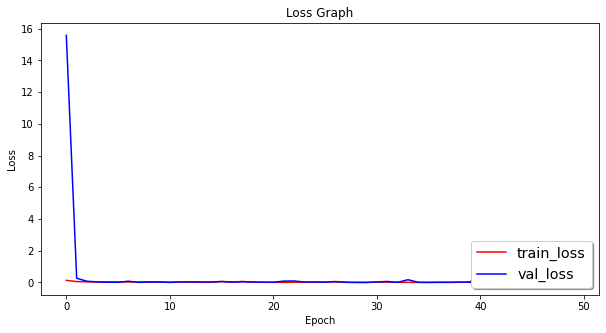

In [0]:
plt.figure(figsize=(10,5))
plt.title('Loss Graph')
plt.plot(epoches,train_loss_hist,'r',label='train_loss')
plt.plot(epoches,val_loss_hist,'b',label='val_loss')
plt.legend(loc='lower right', shadow=True, fontsize='x-large')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.savefig(loss_fig_path)
plt.show()

## 7) Accuracy Graph

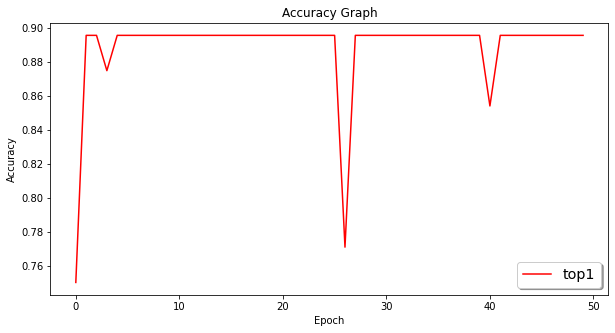

In [0]:
plt.figure(figsize=(10,5))
plt.title('Accuracy Graph')
plt.plot(epoches,top1_acc,'r',label='top1')
# plt.plot(epoches,top3_acc,'b',label='top3')
plt.legend(loc='lower right', shadow=True, fontsize='x-large')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.savefig(acc_fig_path)
plt.show()

In [0]:
checkpoint = torch.load(checkpoint_path)
model.load_state_dict(checkpoint['model'])

<All keys matched successfully>

## 8) Confusion matrix calculation

In [0]:
confusion_matrix = np.zeros((len(class_names),len(class_names)))
total_class_samples = np.zeros((len(class_names),1))

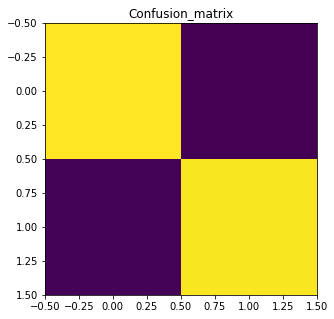

In [0]:
with torch.set_grad_enabled(False):
  for i,(x,y) in enumerate(val_loader):
    output = model(x[:,:,:,:,:].view(x.shape[0],3,-1,112,112).cuda())
    val,idx = softmax(output).topk(1)
    for j in range(y.shape[0]):
      total_class_samples[y[j].item(),0]+=1
      confusion_matrix[y[j].item(),idx[j].item()]+=1
  for i in range(total_class_samples.shape[0]):
    confusion_matrix[i,:] = confusion_matrix[i,:]/total_class_samples[i,0]
plt.figure(figsize=(5,5))
plt.title('Confusion_matrix')
plt.imshow(confusion_matrix)
plt.savefig(confusion_matrix_path)
plt.show()

In [0]:
class_names

[['walking'], ['golf_swing']]

## 9) How to infer Model using video streams

In [0]:
import warnings
warnings.filterwarnings('ignore')
import cv2
from PIL import  Image

In [0]:
transform = torchvision.transforms.Compose([torchvision.transforms.Resize((112,112)),torchvision.transforms.ToTensor(),torchvision.transforms.Normalize(mean=mean,std=std)])

In [0]:
#utility fuction
def get_video(filename,length_in_frames,between_clips):
    cap = cv2.VideoCapture(filename)
    img_list = []
    count = 0 
    h,w = 0,0
    r = between_clips
    while True:
      status,img = cap.read()
      if status==True:
        if count% r == 0:
          h,w,c = img.shape
          img = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
          img_list.append(transform((Image.fromarray(img.copy(),'RGB'))).unsqueeze(0))

      elif (status == False)& (count!=0):
        if count% r == 0:
          img_list.append(transform((Image.fromarray(np.zeros((h,w,3),dtype=np.uint8), 'RGB'))).unsqueeze(0))
      else:
        print('Issue in file:',filename)
        print("NO SUCH VIDEO FILE FOUND!")
        break
      count +=1
      if len(img_list) >= length_in_frames:
        break
    cap.release()
    return torch.cat(img_list,dim=0)

In [0]:
id = 10
test_video = get_video(dataset_path+test_list[id][0],length_in_frames=LENGTH_IN_FRAMES,between_clips=BETWEEN_CLIPS)

In [0]:
test_video.shape #4D tensor should be changes to 5D tensor

torch.Size([32, 3, 112, 112])

In [0]:
test_video = test_video.unsqueeze(0)
test_video.shape

torch.Size([1, 32, 3, 112, 112])

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

torch.Size([1, 1])


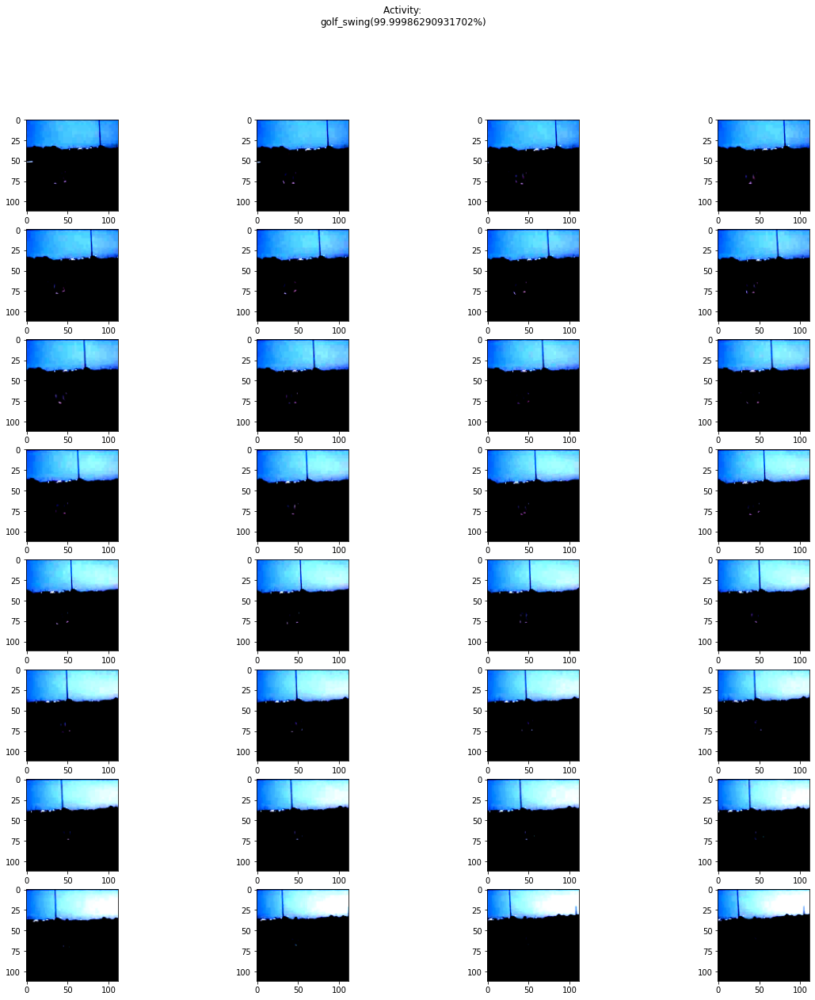

In [0]:
with torch.set_grad_enabled(False):
  fig, axs = plt.subplots(LENGTH_IN_FRAMES//4, 4, figsize=(20, 20))
  output = model(test_video[:,:,:,:,:].view(test_video.shape[0],3,-1,112,112).cuda())
  # val,idx = softmax(output).topk(3)
  val,idx = softmax(output).topk(1)
  string = ''
  print(idx.shape)
  for k in range(idx.shape[1]):
    string += '\n'+class_names[idx[0,k].item()][0] + '('+str(val[0,k].item()*100)+'%'+')'
  fig.suptitle('Activity: '+string)
  r,c = LENGTH_IN_FRAMES//4,4
  count =0
  for i in range(r):
    for j in range(c):
      axs[i,j].imshow(test_video[0,count,:,:,:].transpose(0,2).transpose(0,1))
      count +=1
  plt.savefig(source+'sample_output'+str(id)+'.png')
  plt.show()

In [0]:
for l in range(len(test_list)):
  test_video = get_video(dataset_path+test_list[l][0],length_in_frames=LENGTH_IN_FRAMES,between_clips=BETWEEN_CLIPS)
  test_video = test_video.unsqueeze(0)
  with torch.set_grad_enabled(False):
    fig, axs = plt.subplots(LENGTH_IN_FRAMES//4, 4, figsize=(20, 20))
    output = model(test_video[:,:,:,:,:].view(test_video.shape[0],3,-1,112,112).cuda())
    # val,idx = softmax(output).topk(3)
    val,idx = softmax(output).topk(1)
    string = ''
    for k in range(idx.shape[1]):
      string += '\n'+class_names[idx[0,k].item()][0] + '('+str(val[0,k].item()*100)+'%'+')'
    fig.suptitle('Activity: '+string)
    r,c = LENGTH_IN_FRAMES//4,4
    count =0
    for i in range(r):
      for j in range(c):
        axs[i,j].imshow(test_video[0,count,:,:,:].transpose(0,2).transpose(0,1))
        count +=1
    plt.savefig(source+'test_image'+str(l)+'.png')

# Model 2 (R(2+1)D) : 

In [0]:
source=str(LENGTH_IN_FRAMES)+'ucf2_frame_exp_r2p1d_'+str(BETWEEN_CLIPS)+'/'
os.system('mkdir '+source)
checkpoint_path = source+'checkpoint_r2p1d_32f.pth'
loss_fig_path = source+'Loss.png'
acc_fig_path = source+'acc.png'
confusion_matrix_path = source+'confusion_matrix.png'
graph_hist_path = source+'graph_hist.pth'

## 1) R2P1D class:

In [0]:
class R2P1D(torch.nn.Module):
  def __init__(self,num_of_classes,fine_tune):
    super(R2P1D,self).__init__()
    self.num_of_classes = num_of_classes
    model = torchvision.models.video.r2plus1d_18(pretrained=fine_tune)
    model = list(model.children())[:-1] #removed last fc layer
    self.num_of_layers = len(model)
    self.r2p1d = torch.nn.Sequential(*model)
    self.fc = torch.nn.Linear(in_features=512,out_features=self.num_of_classes,bias=True)
    self.finetune(flag=fine_tune)
  def forward(self,x):
    x = self.r2p1d(x)  
    x = self.fc(x.view(-1,512))
    return  x
  
  def finetune(self,flag):
    if flag == False:
      for p in self.r2p1d.parameters():
        p.requires_grad = True
    else:
      for p in self.r2p1d.parameters():
        p.requires_grad = False
      for c in list(self.r2p1d.children())[2:]:
        for p in c.parameters():
          p.requires_grad = flag

In [0]:
model = R2P1D(num_of_classes=NUM_OF_CLASSES,fine_tune=True).cuda()

Downloading: "https://download.pytorch.org/models/r2plus1d_18-91a641e6.pth" to /root/.cache/torch/checkpoints/r2plus1d_18-91a641e6.pth


In [0]:
optimizer = torch.optim.Adam(params=model.parameters(),lr=1e-2)
loss_fn = torch.nn.CrossEntropyLoss().cuda()
train_loss_hist = []
val_loss_hist = []
top1_acc = []
# top3_acc = []
epoches = []
best_top1 = 0
best_epoch = 0

In [0]:
#utility fuction
def softmax(x):
  return torch.exp(x)/torch.sum(torch.exp(x))

In [0]:
for e in tqdm.tqdm(range(EPOCHES)):
  epoches.append(e)
  train_loss = 0
  val_loss = 0
  train_count = 0
  val_count = 0
  top1_count = 0
  # top3_count = 0
  model.train()
  for i,(x,y) in enumerate(train_loader):
      optimizer.zero_grad()
      output = model(x[:,:,:,:,:].view(x.shape[0],3,-1,112,112).cuda())
      loss = loss_fn(output,y.cuda())
      loss.backward()
      optimizer.step()
      train_loss += loss.item()
      train_count +=batch_size
  train_loss_hist.append(train_loss/train_count)

  model.eval()
  with torch.no_grad():
    for i,(x,y) in enumerate(val_loader):
        output = model(x[:,:,:,:,:].view(x.shape[0],3,-1,112,112).cuda())
        loss = loss_fn(output,y.cuda())
        val_loss += loss.item()
        val_count += batch_size
        
        value_top1,idx_top1 = softmax(output).topk(1)
        # value_top3,idx_top3 = softmax(output).topk(3)
        for j in range(y.shape[0]):
          if y[j].cuda() in idx_top1:
            top1_count += 1
          # if y[j].cuda() in idx_top3:
          #   top3_count += 1
    val_loss_hist.append(val_loss/val_count)
    top1_acc.append(top1_count/val_count)
    # top3_acc.append(top3_count/val_count)
  # print('Epoch: ',e,'train_loss: ',train_loss/train_count,'val_loss: ',val_loss/val_count,'top1_acc:',top1_count/val_count,'top3_acc:',top3_count/val_count,'best_top1:',best_top1,'best_epoch:',best_epoch)
  print('Epoch: ',e,'train_loss: ',train_loss/train_count,'val_loss: ',val_loss/val_count,'top1_acc:',top1_count/val_count,'best_top1:',best_top1,'best_epoch:',best_epoch)
  if best_top1 < (top1_count/val_count):
    best_epoch = e
    best_top1 = (top1_count/val_count)
    torch.save({'model':model.state_dict(),'optimizer':optimizer,'loss_fn':loss_fn,'epoch':e},checkpoint_path)
    # torch.save({'train_loss':train_loss_hist,'val_loss':val_loss_hist,'top1_acc':top1_acc,'top3_acc':top3_acc},graph_hist_path)
    torch.save({'train_loss':train_loss_hist,'val_loss':val_loss_hist,'top1_acc':top1_acc},graph_hist_path)

  0%|          | 0/50 [00:00<?, ?it/s]

Epoch:  0 train_loss:  0.13425931795721963 val_loss:  281.69633356730145 top1_acc: 0.7708333333333334 best_top1: 0 best_epoch: 0


  2%|▏         | 1/50 [00:17<14:35, 17.87s/it]

Epoch:  1 train_loss:  0.06942487029092652 val_loss:  0.4977291173612078 top1_acc: 0.8541666666666666 best_top1: 0.7708333333333334 best_epoch: 0


  4%|▍         | 2/50 [00:34<14:01, 17.52s/it]

Epoch:  2 train_loss:  0.040604881277041774 val_loss:  0.09056693501770496 top1_acc: 0.8958333333333334 best_top1: 0.8541666666666666 best_epoch: 1


  8%|▊         | 4/50 [01:07<12:57, 16.91s/it]

Epoch:  3 train_loss:  0.0794186925160743 val_loss:  3.2796725258231163 top1_acc: 0.5833333333333334 best_top1: 0.8958333333333334 best_epoch: 2


 10%|█         | 5/50 [01:23<12:25, 16.56s/it]

Epoch:  4 train_loss:  0.0521155810870585 val_loss:  0.01636522858340565 top1_acc: 0.8958333333333334 best_top1: 0.8958333333333334 best_epoch: 2


 12%|█▏        | 6/50 [01:38<11:57, 16.31s/it]

Epoch:  5 train_loss:  0.03465980477631092 val_loss:  0.013869144798566898 top1_acc: 0.8958333333333334 best_top1: 0.8958333333333334 best_epoch: 2


 14%|█▍        | 7/50 [01:54<11:33, 16.13s/it]

Epoch:  6 train_loss:  0.042352008544618173 val_loss:  0.02631159545853734 top1_acc: 0.8958333333333334 best_top1: 0.8958333333333334 best_epoch: 2


 16%|█▌        | 8/50 [02:10<11:12, 16.02s/it]

Epoch:  7 train_loss:  0.024427568983464015 val_loss:  0.025444853158357244 top1_acc: 0.8958333333333334 best_top1: 0.8958333333333334 best_epoch: 2


 18%|█▊        | 9/50 [02:26<10:52, 15.93s/it]

Epoch:  8 train_loss:  0.030464043153361195 val_loss:  0.02860595068583886 top1_acc: 0.8958333333333334 best_top1: 0.8958333333333334 best_epoch: 2


 20%|██        | 10/50 [02:41<10:35, 15.88s/it]

Epoch:  9 train_loss:  0.017155635503253767 val_loss:  0.012380618184882527 top1_acc: 0.8958333333333334 best_top1: 0.8958333333333334 best_epoch: 2


 22%|██▏       | 11/50 [02:57<10:17, 15.82s/it]

Epoch:  10 train_loss:  0.04190646790500198 val_loss:  0.015501069991538921 top1_acc: 0.8958333333333334 best_top1: 0.8958333333333334 best_epoch: 2


 24%|██▍       | 12/50 [03:13<10:00, 15.79s/it]

Epoch:  11 train_loss:  0.024722192480805375 val_loss:  0.01832413285349806 top1_acc: 0.8958333333333334 best_top1: 0.8958333333333334 best_epoch: 2


 26%|██▌       | 13/50 [03:28<09:43, 15.77s/it]

Epoch:  12 train_loss:  0.018122290527181967 val_loss:  0.00641042316177239 top1_acc: 0.8958333333333334 best_top1: 0.8958333333333334 best_epoch: 2


 28%|██▊       | 14/50 [03:44<09:27, 15.76s/it]

Epoch:  13 train_loss:  0.01334656211769297 val_loss:  0.012117012607632205 top1_acc: 0.8958333333333334 best_top1: 0.8958333333333334 best_epoch: 2


 30%|███       | 15/50 [04:00<09:11, 15.76s/it]

Epoch:  14 train_loss:  0.030878903122530096 val_loss:  0.005490549631455603 top1_acc: 0.8958333333333334 best_top1: 0.8958333333333334 best_epoch: 2


 32%|███▏      | 16/50 [04:16<08:55, 15.76s/it]

Epoch:  15 train_loss:  0.024790698795446327 val_loss:  0.020324450296660263 top1_acc: 0.8958333333333334 best_top1: 0.8958333333333334 best_epoch: 2


 34%|███▍      | 17/50 [04:31<08:39, 15.75s/it]

Epoch:  16 train_loss:  0.009851205783585707 val_loss:  0.02047288402294119 top1_acc: 0.875 best_top1: 0.8958333333333334 best_epoch: 2


 36%|███▌      | 18/50 [04:47<08:23, 15.74s/it]

Epoch:  17 train_loss:  0.013509118330797978 val_loss:  0.007338138711020292 top1_acc: 0.8958333333333334 best_top1: 0.8958333333333334 best_epoch: 2


 38%|███▊      | 19/50 [05:03<08:07, 15.74s/it]

Epoch:  18 train_loss:  0.021153405619164307 val_loss:  0.005722203136732181 top1_acc: 0.8958333333333334 best_top1: 0.8958333333333334 best_epoch: 2


 40%|████      | 20/50 [05:19<07:51, 15.73s/it]

Epoch:  19 train_loss:  0.01262645088579683 val_loss:  0.014021081384271383 top1_acc: 0.8958333333333334 best_top1: 0.8958333333333334 best_epoch: 2


 42%|████▏     | 21/50 [05:34<07:36, 15.75s/it]

Epoch:  20 train_loss:  0.009119938438137373 val_loss:  0.00861374671512749 top1_acc: 0.8958333333333334 best_top1: 0.8958333333333334 best_epoch: 2


 44%|████▍     | 22/50 [05:50<07:20, 15.74s/it]

Epoch:  21 train_loss:  0.0052272748379480274 val_loss:  0.0028133649999896684 top1_acc: 0.8958333333333334 best_top1: 0.8958333333333334 best_epoch: 2


 46%|████▌     | 23/50 [06:06<07:04, 15.74s/it]

Epoch:  22 train_loss:  0.004564650356769562 val_loss:  0.032218846337248884 top1_acc: 0.8541666666666666 best_top1: 0.8958333333333334 best_epoch: 2


 48%|████▊     | 24/50 [06:22<06:49, 15.73s/it]

Epoch:  23 train_loss:  0.016133697393039863 val_loss:  0.04139830761899551 top1_acc: 0.8958333333333334 best_top1: 0.8958333333333334 best_epoch: 2


 50%|█████     | 25/50 [06:37<06:33, 15.74s/it]

Epoch:  24 train_loss:  0.01573002642197978 val_loss:  0.03024014978048702 top1_acc: 0.8958333333333334 best_top1: 0.8958333333333334 best_epoch: 2


 52%|█████▏    | 26/50 [06:53<06:17, 15.73s/it]

Epoch:  25 train_loss:  0.00593403662510571 val_loss:  0.010593075203360058 top1_acc: 0.8958333333333334 best_top1: 0.8958333333333334 best_epoch: 2


 54%|█████▍    | 27/50 [07:09<06:01, 15.73s/it]

Epoch:  26 train_loss:  0.017275366089528517 val_loss:  0.039150530782838665 top1_acc: 0.8958333333333334 best_top1: 0.8958333333333334 best_epoch: 2


 56%|█████▌    | 28/50 [07:24<05:46, 15.73s/it]

Epoch:  27 train_loss:  0.010364732749405362 val_loss:  0.009792082322140535 top1_acc: 0.8958333333333334 best_top1: 0.8958333333333334 best_epoch: 2


 58%|█████▊    | 29/50 [07:40<05:30, 15.75s/it]

Epoch:  28 train_loss:  0.005596947678852649 val_loss:  0.010925729551975868 top1_acc: 0.8958333333333334 best_top1: 0.8958333333333334 best_epoch: 2


 60%|██████    | 30/50 [07:56<05:14, 15.74s/it]

Epoch:  29 train_loss:  0.0040985820814967155 val_loss:  0.00258781564328577 top1_acc: 0.8958333333333334 best_top1: 0.8958333333333334 best_epoch: 2


 62%|██████▏   | 31/50 [08:12<04:59, 15.75s/it]

Epoch:  30 train_loss:  0.0024816645309329033 val_loss:  0.03733366665740808 top1_acc: 0.8958333333333334 best_top1: 0.8958333333333334 best_epoch: 2


 64%|██████▍   | 32/50 [08:27<04:43, 15.74s/it]

Epoch:  31 train_loss:  0.0058044300725062685 val_loss:  0.00984341811605797 top1_acc: 0.8958333333333334 best_top1: 0.8958333333333334 best_epoch: 2


 66%|██████▌   | 33/50 [08:43<04:27, 15.74s/it]

Epoch:  32 train_loss:  0.014851061383350975 val_loss:  0.0055754235945641994 top1_acc: 0.8958333333333334 best_top1: 0.8958333333333334 best_epoch: 2


 68%|██████▊   | 34/50 [08:59<04:11, 15.74s/it]

Epoch:  33 train_loss:  0.004639195854819957 val_loss:  0.01597258360804214 top1_acc: 0.8958333333333334 best_top1: 0.8958333333333334 best_epoch: 2


 70%|███████   | 35/50 [09:15<03:56, 15.74s/it]

Epoch:  34 train_loss:  0.02268546766468457 val_loss:  0.044626069255173206 top1_acc: 0.8958333333333334 best_top1: 0.8958333333333334 best_epoch: 2


 72%|███████▏  | 36/50 [09:30<03:40, 15.74s/it]

Epoch:  35 train_loss:  0.008988924346686829 val_loss:  0.019870662596076727 top1_acc: 0.8958333333333334 best_top1: 0.8958333333333334 best_epoch: 2


 74%|███████▍  | 37/50 [09:46<03:24, 15.73s/it]

Epoch:  36 train_loss:  0.0041098834148475104 val_loss:  0.006816695133845012 top1_acc: 0.8958333333333334 best_top1: 0.8958333333333334 best_epoch: 2


 76%|███████▌  | 38/50 [10:02<03:08, 15.72s/it]

Epoch:  37 train_loss:  0.001050062832378206 val_loss:  0.002308385524277886 top1_acc: 0.8958333333333334 best_top1: 0.8958333333333334 best_epoch: 2


 78%|███████▊  | 39/50 [10:18<02:53, 15.73s/it]

Epoch:  38 train_loss:  0.0004556313423173768 val_loss:  0.002160535297472658 top1_acc: 0.8958333333333334 best_top1: 0.8958333333333334 best_epoch: 2


 80%|████████  | 40/50 [10:33<02:37, 15.73s/it]

Epoch:  39 train_loss:  0.0025573082135191987 val_loss:  0.007843598930170023 top1_acc: 0.8958333333333334 best_top1: 0.8958333333333334 best_epoch: 2


 82%|████████▏ | 41/50 [10:49<02:21, 15.72s/it]

Epoch:  40 train_loss:  0.001656857430047932 val_loss:  0.011820858033994833 top1_acc: 0.8958333333333334 best_top1: 0.8958333333333334 best_epoch: 2


 84%|████████▍ | 42/50 [11:05<02:05, 15.72s/it]

Epoch:  41 train_loss:  0.007184282543935946 val_loss:  0.007405661356945832 top1_acc: 0.8958333333333334 best_top1: 0.8958333333333334 best_epoch: 2


 86%|████████▌ | 43/50 [11:20<01:50, 15.73s/it]

Epoch:  42 train_loss:  0.012729754627105735 val_loss:  0.0226599241917332 top1_acc: 0.875 best_top1: 0.8958333333333334 best_epoch: 2


 88%|████████▊ | 44/50 [11:36<01:34, 15.75s/it]

Epoch:  43 train_loss:  0.0030263641937857584 val_loss:  0.03450628944362203 top1_acc: 0.8958333333333334 best_top1: 0.8958333333333334 best_epoch: 2


 90%|█████████ | 45/50 [11:52<01:18, 15.75s/it]

Epoch:  44 train_loss:  0.0018203468505470525 val_loss:  0.00511965062469244 top1_acc: 0.8958333333333334 best_top1: 0.8958333333333334 best_epoch: 2


 92%|█████████▏| 46/50 [12:08<01:03, 15.76s/it]

Epoch:  45 train_loss:  0.003967181624223788 val_loss:  0.015835781892140705 top1_acc: 0.8958333333333334 best_top1: 0.8958333333333334 best_epoch: 2


 94%|█████████▍| 47/50 [12:24<00:47, 15.76s/it]

Epoch:  46 train_loss:  0.005075489392592793 val_loss:  0.02525847425901399 top1_acc: 0.8958333333333334 best_top1: 0.8958333333333334 best_epoch: 2


 96%|█████████▌| 48/50 [12:39<00:31, 15.76s/it]

Epoch:  47 train_loss:  0.0077916110998817855 val_loss:  0.031943731320401035 top1_acc: 0.875 best_top1: 0.8958333333333334 best_epoch: 2


 98%|█████████▊| 49/50 [12:55<00:15, 15.75s/it]

Epoch:  48 train_loss:  0.0031625281664587205 val_loss:  0.0050055466384340734 top1_acc: 0.8958333333333334 best_top1: 0.8958333333333334 best_epoch: 2


100%|██████████| 50/50 [13:11<00:00, 15.83s/it]

Epoch:  49 train_loss:  0.0013806467787140892 val_loss:  0.008985506370663643 top1_acc: 0.8958333333333334 best_top1: 0.8958333333333334 best_epoch: 2


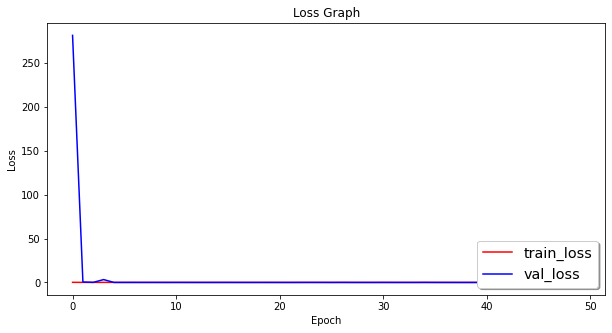

In [0]:
plt.figure(figsize=(10,5))
plt.title('Loss Graph')
plt.plot(epoches,train_loss_hist,'r',label='train_loss')
plt.plot(epoches,val_loss_hist,'b',label='val_loss')
plt.legend(loc='lower right', shadow=True, fontsize='x-large')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.savefig(loss_fig_path)
plt.show()

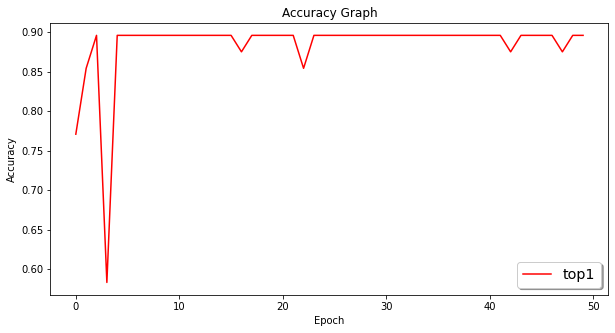

In [0]:
plt.figure(figsize=(10,5))
plt.title('Accuracy Graph')
plt.plot(epoches,top1_acc,'r',label='top1')
# plt.plot(epoches,top3_acc,'b',label='top3')
plt.legend(loc='lower right', shadow=True, fontsize='x-large')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.savefig(acc_fig_path)
plt.show()

In [0]:
checkpoint = torch.load(checkpoint_path)
model.load_state_dict(checkpoint['model'])

<All keys matched successfully>

In [0]:
confusion_matrix = np.zeros((len(class_names),len(class_names)))
total_class_samples = np.zeros((len(class_names),1))

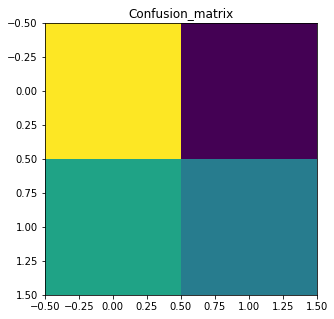

In [0]:
with torch.set_grad_enabled(False):
  for i,(x,y) in enumerate(val_loader):
    output = model(x[:,:,:,:,:].view(x.shape[0],3,-1,112,112).cuda())
    val,idx = softmax(output).topk(1)
    for j in range(y.shape[0]):
      total_class_samples[y[j].item(),0]+=1
      confusion_matrix[y[j].item(),idx[j].item()]+=1
  for i in range(total_class_samples.shape[0]):
    confusion_matrix[i,:] = confusion_matrix[i,:]/total_class_samples[i,0]
plt.figure(figsize=(5,5))
plt.title('Confusion_matrix')
plt.imshow(confusion_matrix)
plt.savefig(confusion_matrix_path)
plt.show()

In [0]:
import warnings
warnings.filterwarnings('ignore')
import cv2
from PIL import  Image

In [0]:
transform = torchvision.transforms.Compose([torchvision.transforms.Resize((112,112)),torchvision.transforms.ToTensor(),torchvision.transforms.Normalize(mean=mean,std=std)])

In [0]:
id = 10
test_video = get_video(dataset_path+test_list[id][0],length_in_frames=LENGTH_IN_FRAMES,between_clips=BETWEEN_CLIPS)

In [0]:
test_video.shape #4D tensor should be changes to 5D tensor

torch.Size([32, 3, 112, 112])

In [0]:
test_video = test_video.unsqueeze(0)
test_video.shape

torch.Size([1, 32, 3, 112, 112])

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

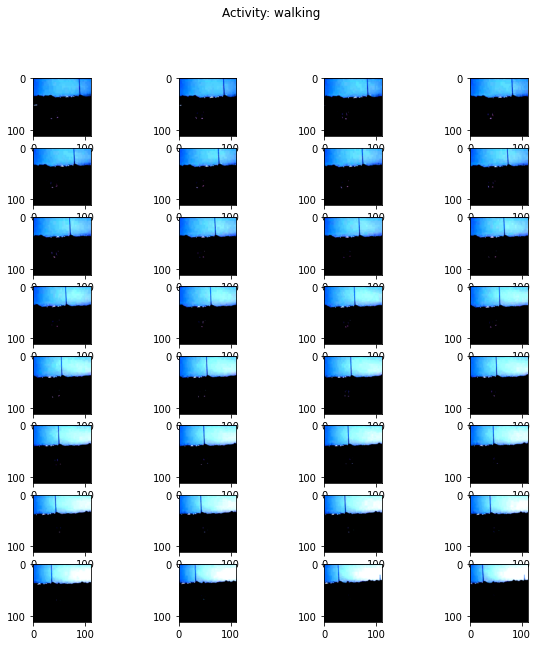

In [0]:
with torch.set_grad_enabled(False):
  fig, axs = plt.subplots(LENGTH_IN_FRAMES//4,4, figsize=(10, 10))
  output = model(test_video[:,:,:,:,:].view(test_video.shape[0],3,-1,112,112).cuda())
  val,idx = softmax(output).topk(1)
  fig.suptitle('Activity: '+class_names[idx[0].item()][0])
  r,c = LENGTH_IN_FRAMES//4,4
  count =0
  for i in range(r):
    for j in range(c):
      axs[i,j].imshow(test_video[0,count,:,:,:].transpose(0,2).transpose(0,1))
      count +=1
  plt.savefig(source+'sample_output.png')
  plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

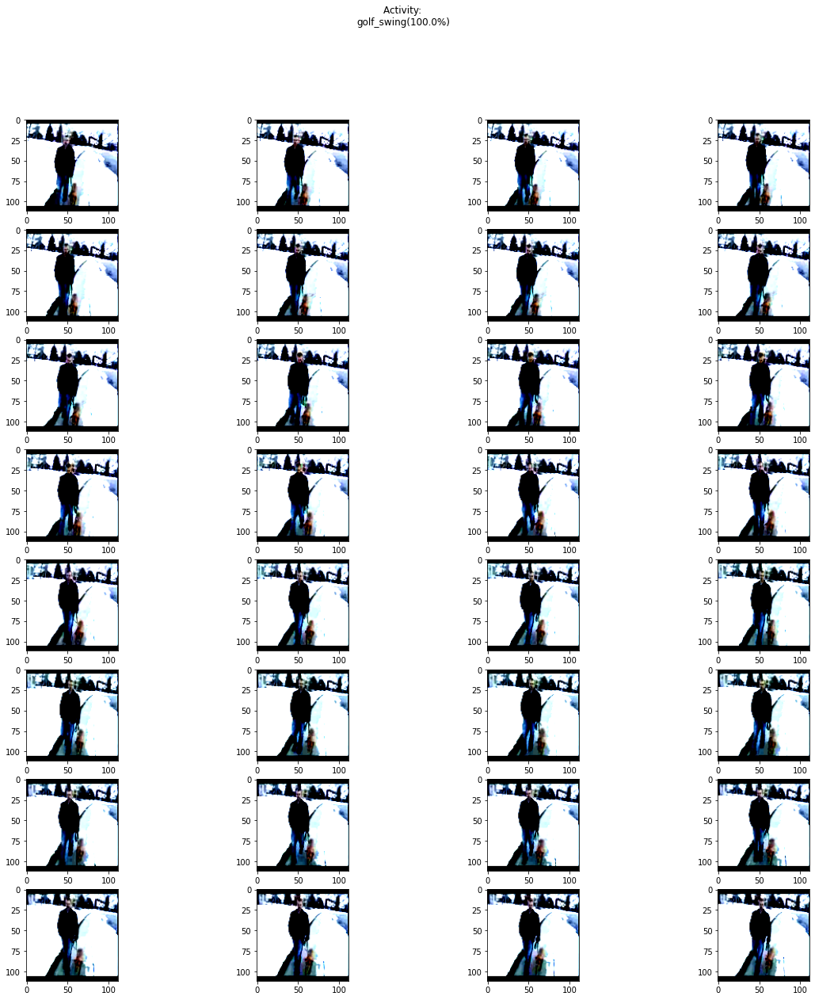

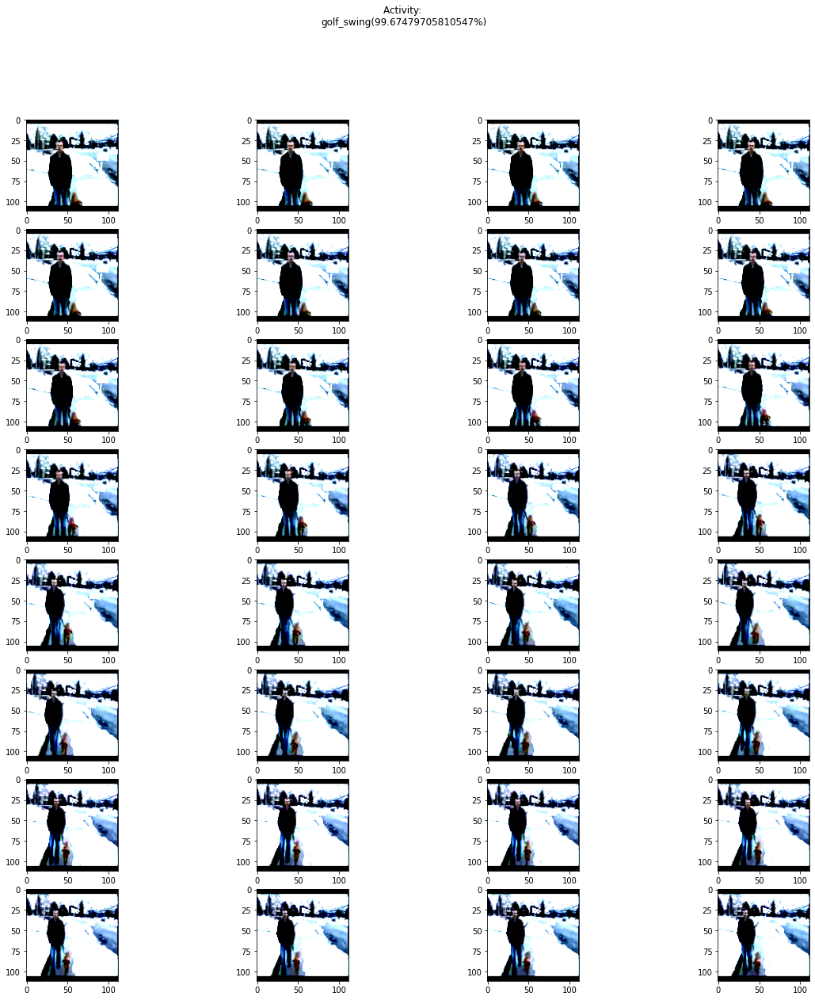

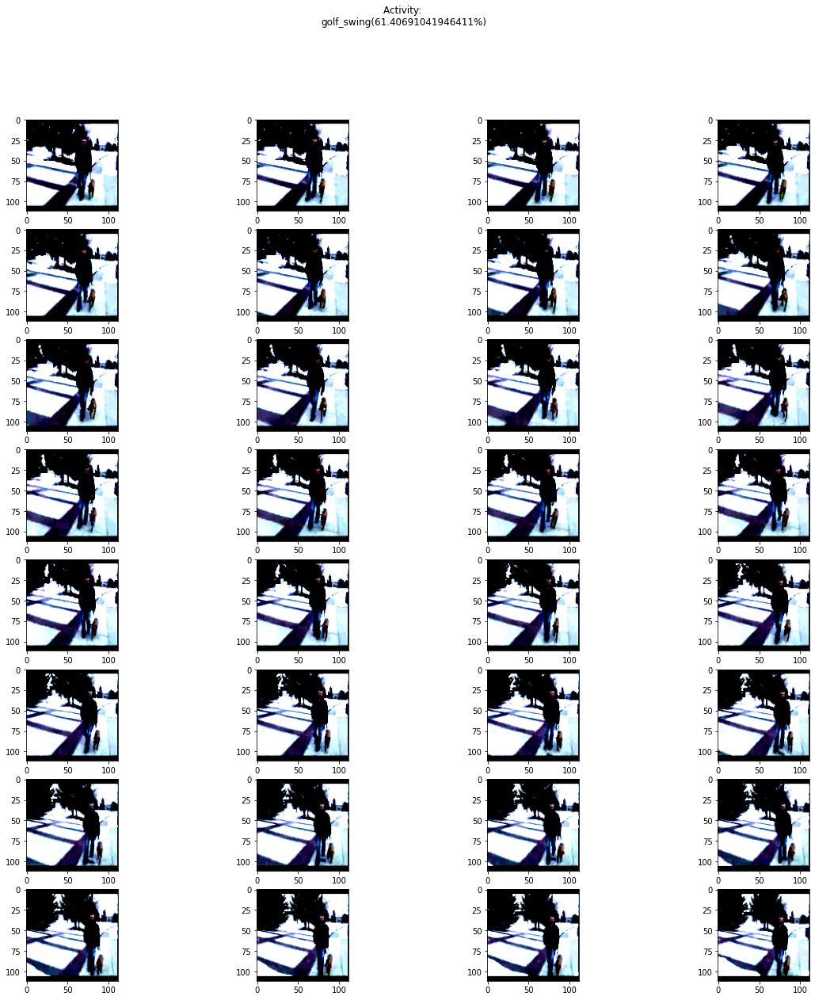

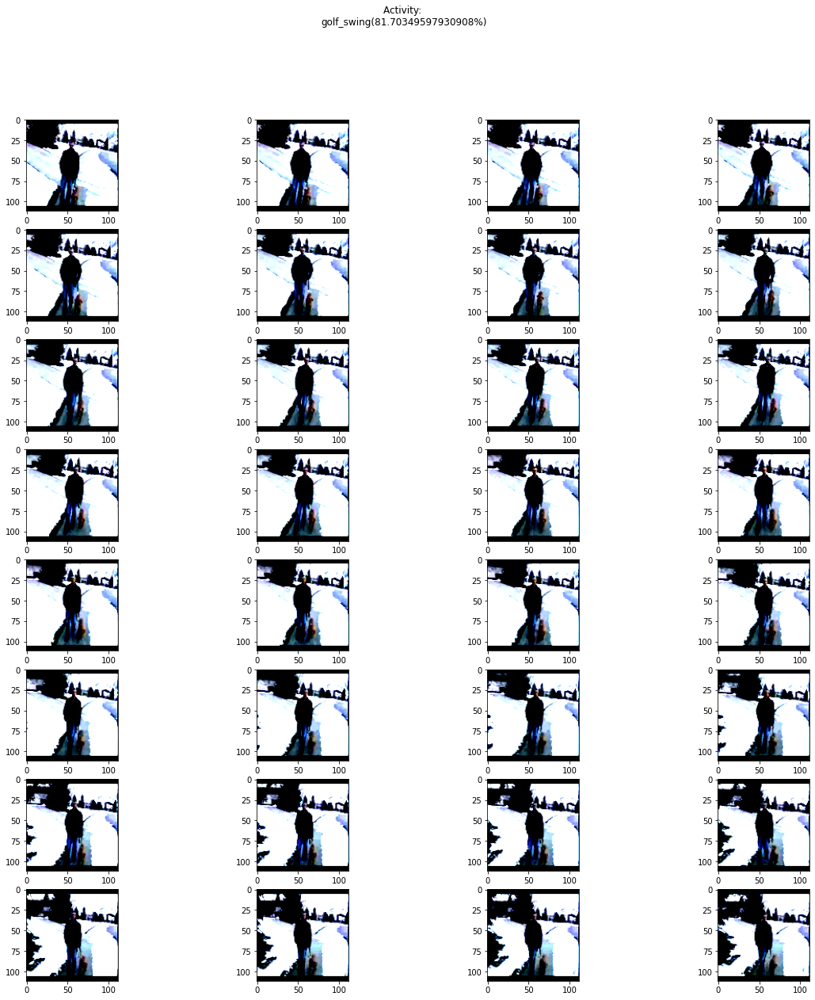

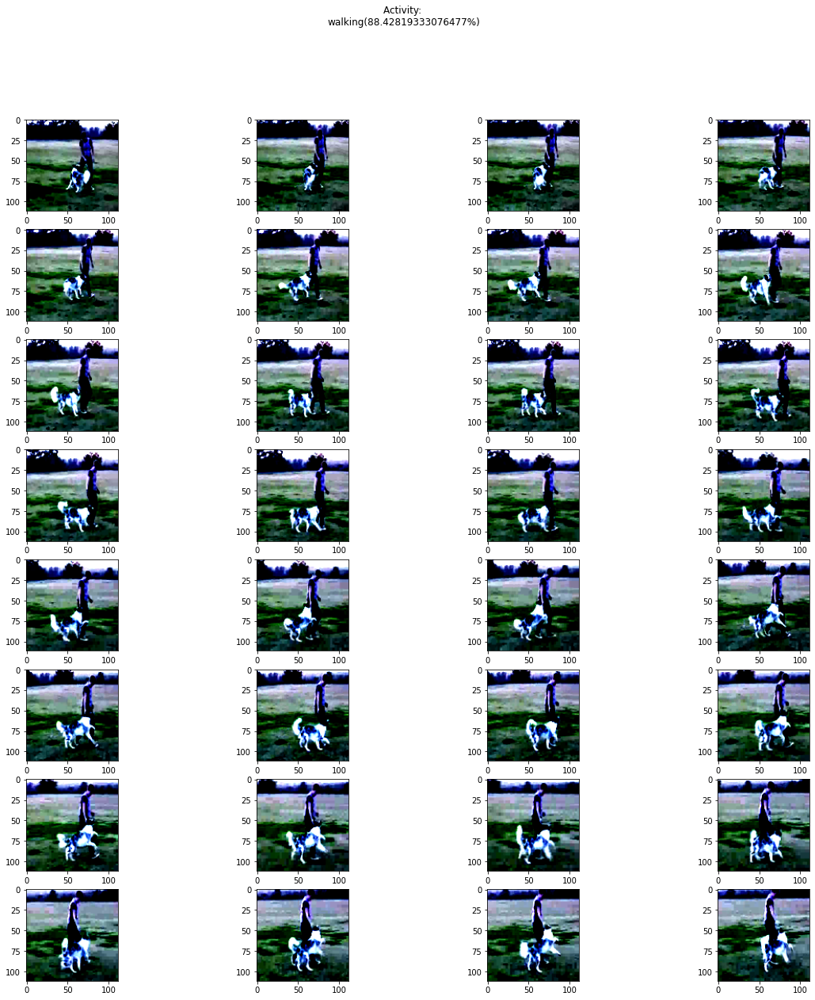

...

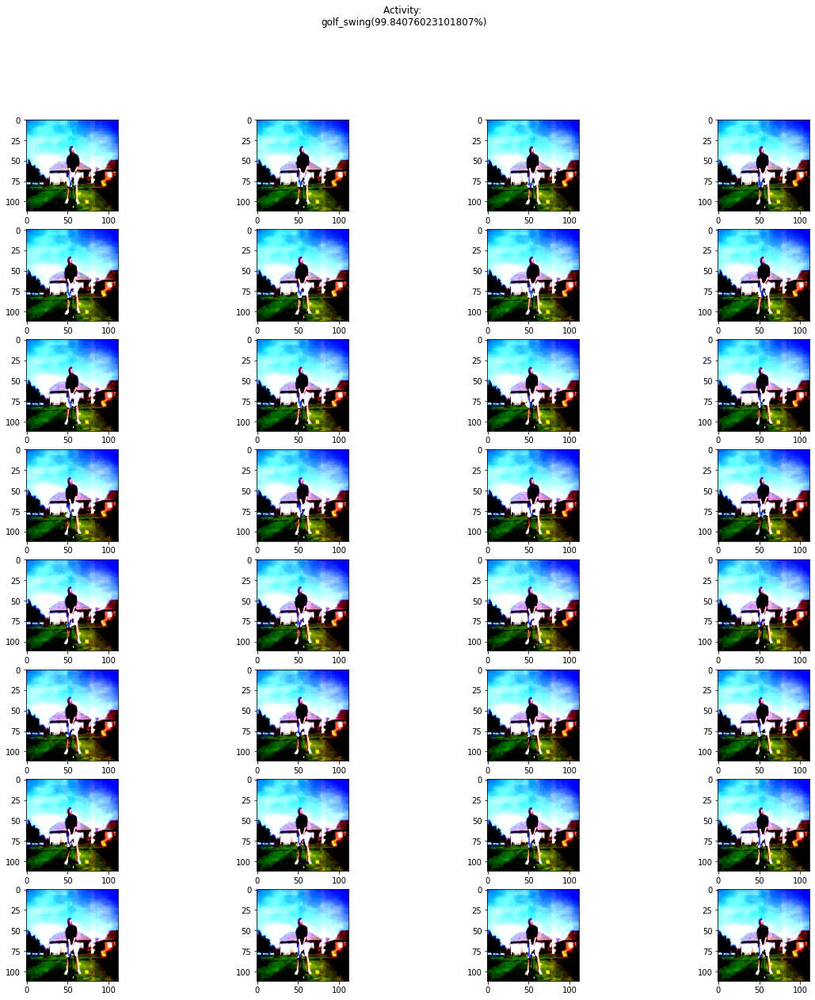

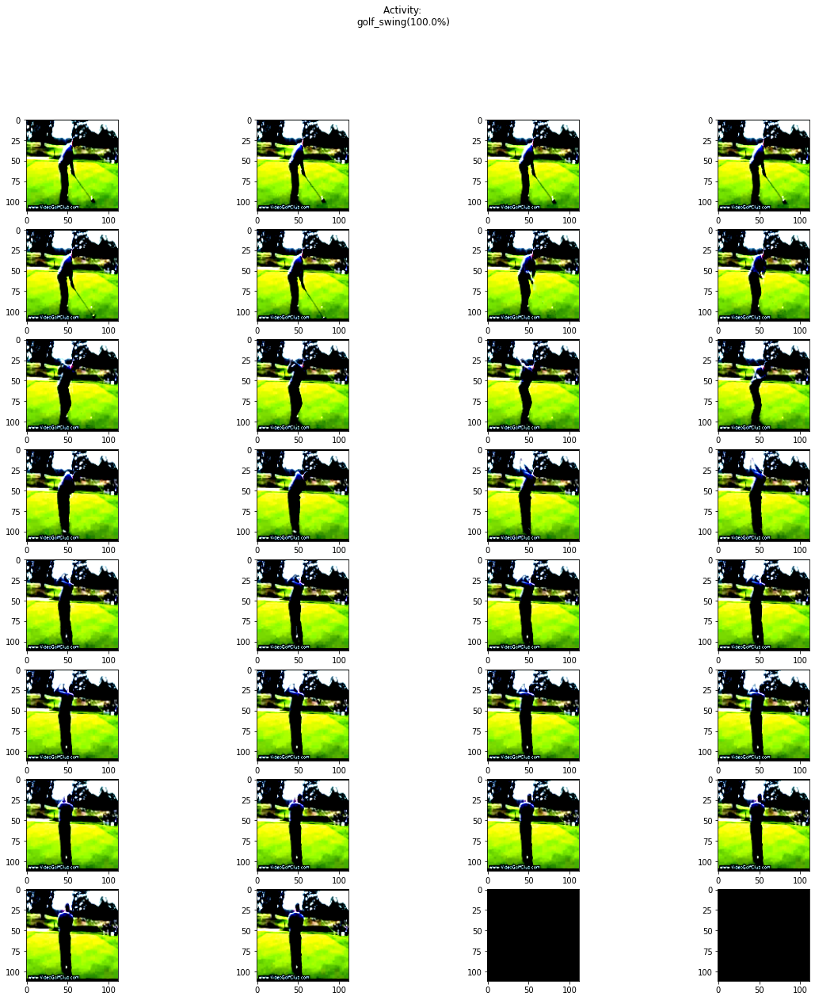

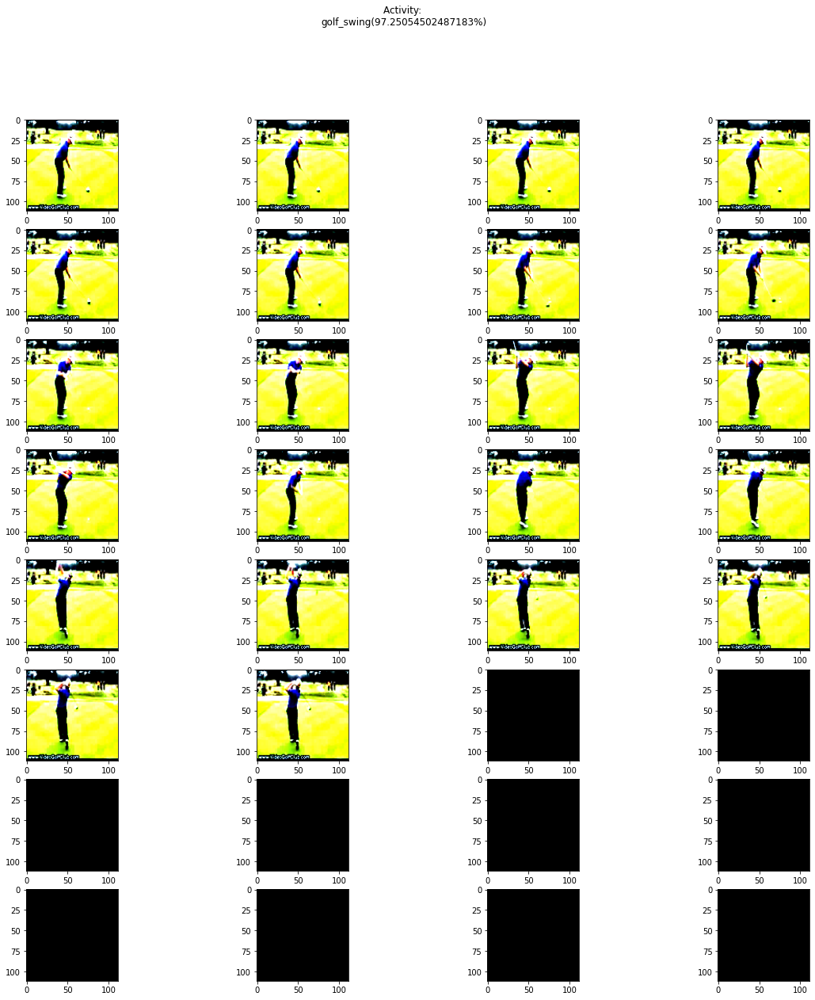

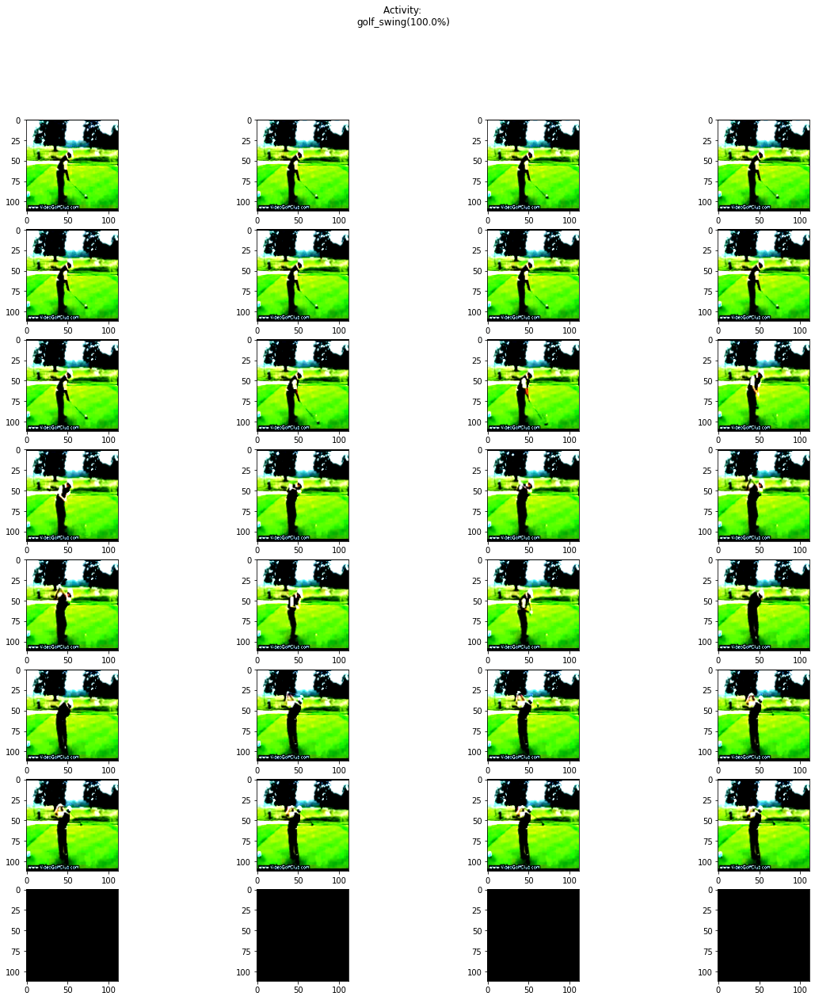

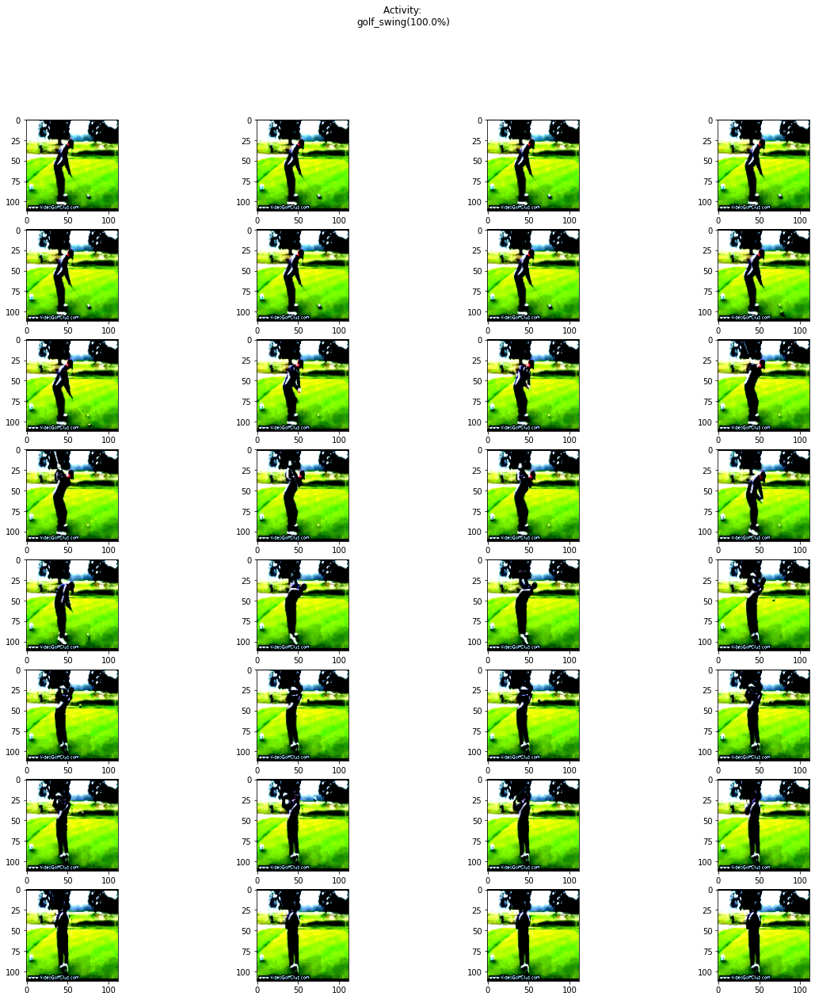

In [0]:
for l in range(len(test_list)):
  test_video = get_video(dataset_path+test_list[l][0],length_in_frames=LENGTH_IN_FRAMES,between_clips=BETWEEN_CLIPS)
  test_video = test_video.unsqueeze(0)
  with torch.set_grad_enabled(False):
    fig, axs = plt.subplots(LENGTH_IN_FRAMES//4,4, figsize=(20, 20))
    output = model(test_video[:,:,:,:,:].view(test_video.shape[0],3,-1,112,112).cuda())
    # val,idx = softmax(output).topk(3)
    val,idx = softmax(output).topk(1)
    string = ''
    for k in range(idx.shape[1]):
      string += '\n'+class_names[idx[0,k].item()][0] + '('+str(val[0,k].item()*100)+'%'+')'
    fig.suptitle('Activity: '+string)
    r,c = LENGTH_IN_FRAMES//4,4
    count =0
    for i in range(r):
      for j in range(c):
        axs[i,j].imshow(test_video[0,count,:,:,:].transpose(0,2).transpose(0,1))
        count +=1
    plt.savefig(source+'test_image'+str(l)+'.png')